In [14]:
import os
import cv2
import numpy as np
from matplotlib import pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [21]:
def preprocess_and_segmentation(image_path, output_folder):
    img = cv2.imread(image_path)
    b, g, r = cv2.split(img)
    rgb_img = cv2.merge([r, g, b])
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ret, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
    kernel = np.ones((2, 2), np.uint8)
    closing = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel, iterations=2)
    sure_bg = cv2.dilate(closing, kernel, iterations=3)
    dist_transform = cv2.distanceTransform(sure_bg, cv2.DIST_L2, 3)
    ret, sure_fg = cv2.threshold(dist_transform, 0.1 * dist_transform.max(), 255, 0)
    sure_fg = np.uint8(sure_fg)
    unknown = cv2.subtract(sure_bg, sure_fg)
    ret, markers = cv2.connectedComponents(sure_fg)
    markers = markers + 1
    markers[unknown == 255] = 0
    markers = cv2.watershed(img, markers)
    img[markers == -1] = [255, 0, 0]
    plt.subplot(211), plt.imshow(rgb_img)
    plt.title('Input Image'), plt.xticks([]), plt.yticks([])
    plt.subplot(212), plt.imshow(thresh, 'gray')
    plt.title("Otsu's binary threshold"), plt.xticks([]), plt.yticks([])
    plt.tight_layout()
    plt.show()
    output_path = os.path.join(output_folder, os.path.basename(image_path))
    cv2.imwrite(output_path, img)

In [17]:
train_folder = 'E:\end to end ml progect\Malaria-Detection\Dataset\Dataset\Train'
test_folder = 'E:\end to end ml progect\Malaria-Detection\Dataset\Dataset\Test'

In [12]:
output_folder_structure = {
    'train': {
        'parasite': 'E:/end to end ml progect/Malaria-Detection/output folder/train/parasite',
        'uninfected': 'E:/end to end ml progect\Malaria-Detection/output folder/train/uninfected',
    },
    'test': {
        'parasite': 'E:/end to end ml progect/Malaria-Detection/output folder/test/parasite',
        'uninfected': 'E:/end to end ml progect/Malaria-Detection/output folder/test/uninfected',
    }
}

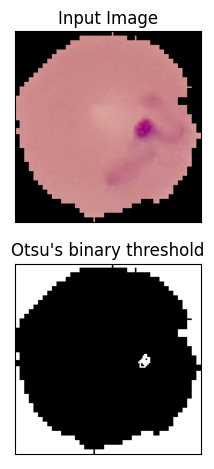

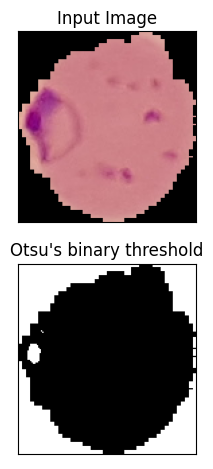

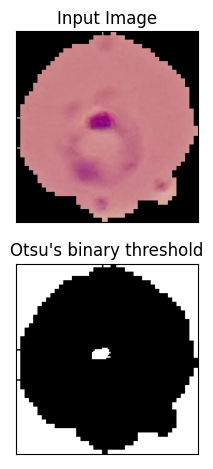

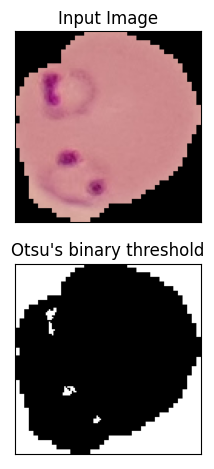

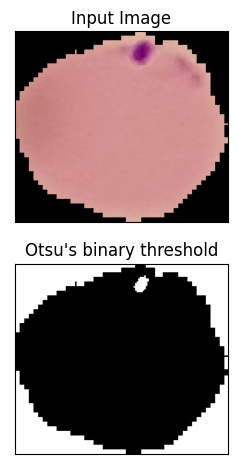

...

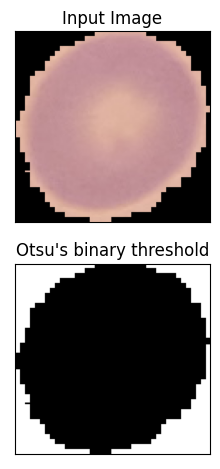

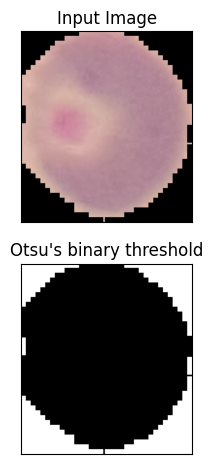

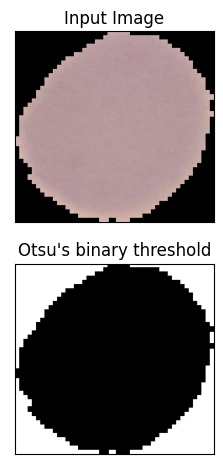

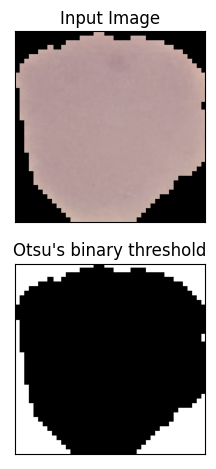

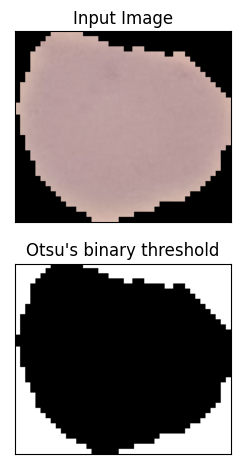

In [22]:
for class_name, output_path in output_folder_structure['train'].items():
    class_folder = os.path.join(train_folder, class_name)
    for filename in os.listdir(class_folder):
        if filename.endswith(".png"):
            image_path = os.path.join(class_folder, filename)
            preprocess_and_segmentation(image_path, output_path)

                               

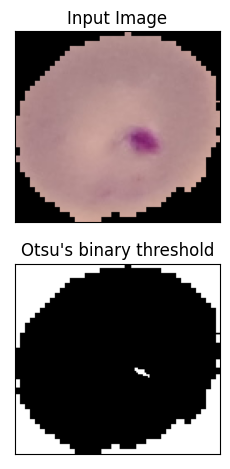

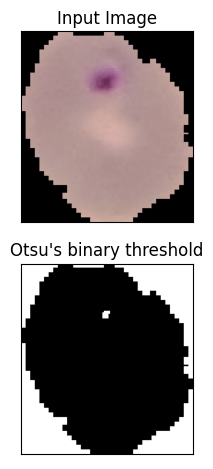

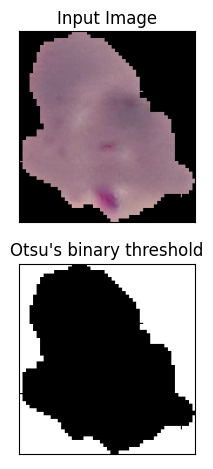

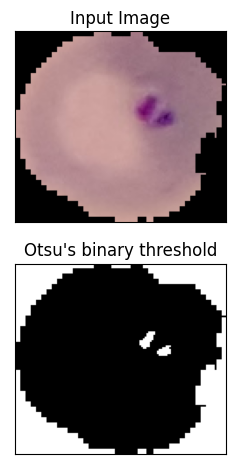

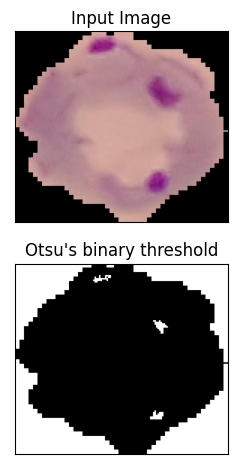

...

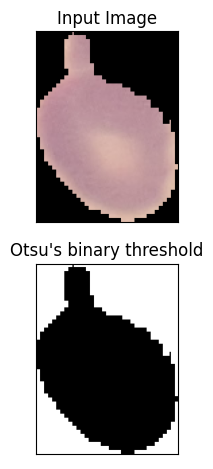

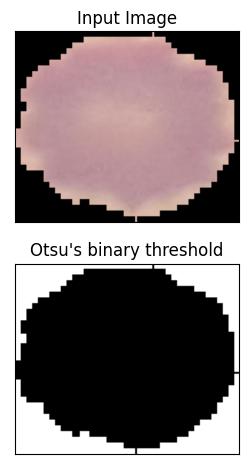

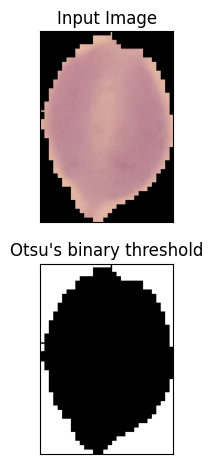

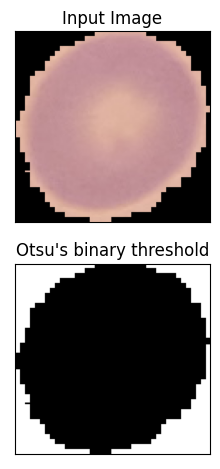

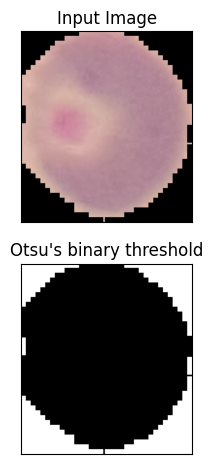

In [23]:
for class_name, output_path in output_folder_structure['test'].items():
    class_folder = os.path.join(test_folder, class_name)
    for filename in os.listdir(class_folder):
        if filename.endswith(".png"):
            image_path = os.path.join(class_folder, filename)
            preprocess_and_segmentation(image_path, output_path)

In [33]:
train_data_dir = 'E:/end to end ml progect/Malaria-Detection/output folder/train'
test_data_dir = 'E:/end to end ml progect/Malaria-Detection/output folder/test'

In [28]:
image_size = (224, 224) 
batch_size = 32

In [25]:
train_datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.10,
    height_shift_range=0.10,
    rescale=1./255,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    fill_mode='nearest'
)

In [26]:
test_datagen = ImageDataGenerator(rescale=1./255)

In [29]:
train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=image_size,
    batch_size=batch_size,
    class_mode='binary',
    shuffle=True 
)

Found 394 images belonging to 2 classes.


In [34]:
test_generator = test_datagen.flow_from_directory(
    test_data_dir,
    target_size=image_size,
    batch_size=batch_size,
    class_mode='binary',
    shuffle=False  
)

Found 134 images belonging to 2 classes.


In [36]:
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Activation, Dropout


In [38]:
image_shape = (224, 224, 3)

In [39]:
model = Sequential()
model.add(Conv2D(filters=32, kernel_size=(3,3),input_shape=image_shape, activation='relu',))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(filters=64, kernel_size=(3,3),input_shape=image_shape, activation='relu',))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(filters=64, kernel_size=(3,3),input_shape=image_shape, activation='relu',))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(128))
model.add(Activation('relu'))
model.add(Dropout(0.5))
model.add(Dense(1))
model.add(Activation('sigmoid'))

In [41]:
model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

In [42]:
history = model.fit_generator(
    train_generator,
    steps_per_epoch=train_generator.samples // batch_size,
    epochs=25,  
    validation_data=test_generator,
    validation_steps=test_generator.samples // batch_size
)

C:\Users\Dhruv\AppData\Local\Temp\ipykernel_29280\56329233.py:1: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(


Epoch 1/25
12/12 [==============================] - 33s 3s/step - loss: 0.9786 - accuracy: 0.5138 - val_loss: 0.6898 - val_accuracy: 0.6641
Epoch 2/25
12/12 [==============================] - 21s 2s/step - loss: 0.6924 - accuracy: 0.5193 - val_loss: 0.6583 - val_accuracy: 0.7109
Epoch 3/25
12/12 [==============================] - 20s 2s/step - loss: 0.7029 - accuracy: 0.5304 - val_loss: 0.6983 - val_accuracy: 0.3281
Epoch 4/25
12/12 [==============================] - 20s 2s/step - loss: 0.6921 - accuracy: 0.5000 - val_loss: 0.6930 - val_accuracy: 0.4766
Epoch 5/25
12/12 [==============================] - 21s 2s/step - loss: 0.6819 - accuracy: 0.5967 - val_loss: 0.7136 - val_accuracy: 0.3750
Epoch 6/25
12/12 [==============================] - 20s 2s/step - loss: 0.6972 - accuracy: 0.5497 - val_loss: 0.7423 - val_accuracy: 0.2969
Epoch 7/25
12/12 [==============================] - 20s 2s/step - loss: 0.6900 - accuracy: 0.5276 - val_loss: 0.7196 - val_accuracy: 0.3125
Epoch 8/25
12/12 [==

In [43]:
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix

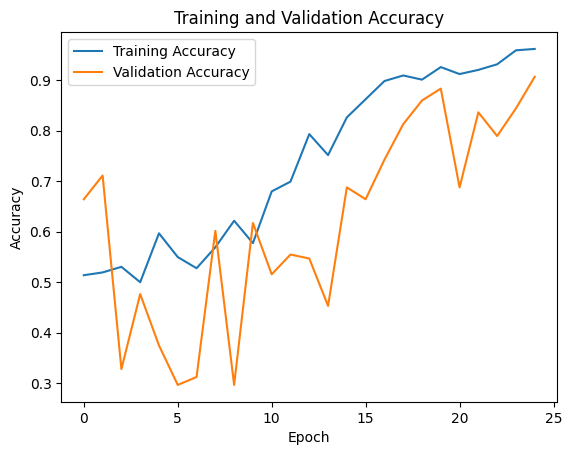

In [44]:
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [45]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f'Test Loss: {test_loss:.4f}')
print(f'Test Accuracy: {test_accuracy:.4f}')

5/5 [==============================] - 1s 244ms/step - loss: 0.2158 - accuracy: 0.9104
Test Loss: 0.2158
Test Accuracy: 0.9104


In [46]:
y_pred = model.predict(test_generator)
y_pred_classes = (y_pred > 0.5).astype(int)

5/5 [==============================] - 1s 233ms/step


In [47]:
y_true = test_generator.classes

In [48]:
print("Classification Report:")
print(classification_report(y_true, y_pred_classes))

Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.87      0.93        91
           1       0.78      1.00      0.88        43

    accuracy                           0.91       134
   macro avg       0.89      0.93      0.90       134
weighted avg       0.93      0.91      0.91       134



In [49]:
print("Confusion Matrix:")
print(confusion_matrix(y_true, y_pred_classes))

Confusion Matrix:
[[79 12]
 [ 0 43]]


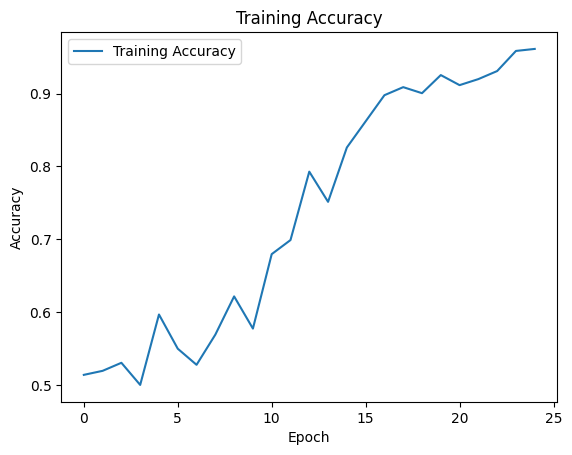

In [50]:
training_accuracy = history.history['accuracy']
plt.plot(training_accuracy, label='Training Accuracy')
plt.title('Training Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [51]:
final_training_accuracy = training_accuracy[-1]
print(f'Final Training Accuracy: {final_training_accuracy:.4f}')

Final Training Accuracy: 0.9613


In [52]:
model.save('malaria.h5')

In [1]:
from tensorflow.keras.models import load_model

loaded_model = load_model('malaria.h5')